In [1]:
import random, time
from IPython import display             # type: ignore
from PIL import Image, ImageDraw        # type: ignore

In [2]:
random.seed(42)

# Definição das características
# GENE_LENGTH = 20                        # Cada mariposa é representada por uma lista de 20 genes (RGB).
# GENERATIONS = 100
# POPULATION_SIZE = 20
# MUTATION_RATE = 0.01

GENE_LENGTH = 200                        # Cada mariposa é representada por uma lista de 20 genes (RGB).
GENERATIONS = 1000
POPULATION_SIZE = 200
MUTATION_RATE = 0.001

# Ambiente (cor de referência: verde-oliva)
environment = (128, 128, 0)  # olive green

In [3]:
def create_genome():
    return [(random.randint(0, 255), random.randint(0, 255), random.randint(0, 255)) for _ in range(GENE_LENGTH)]

def create_population():
    return [create_genome() for _ in range(POPULATION_SIZE)]

def fitness(genome):
    # Calcula a diferença média (Manhattan) entre cada gene (RGB) e o ambiente
    return -sum(sum(abs(gene[i] - environment[i]) for i in range(3)) for gene in genome) / GENE_LENGTH

def selection(population):
    scored = sorted(population, key=fitness, reverse=True)
    return scored[:5]  # Seleciona os 5 melhores

def crossover(parent1, parent2):
    point = random.randint(1, GENE_LENGTH - 1)
    return parent1[:point] + parent2[point:]

def mutate(genome):
    return [(random.randint(0,255), random.randint(0,255), random.randint(0,255)) if random.random() < MUTATION_RATE else gene for gene in genome]

_history = []

population = create_population()  # Implementação do algoritmo genético
best_population = []

for generation in range(GENERATIONS):
    print(f"Geração {generation}: Melhor fitness = {max(population, key=fitness)}")
    
    best_population.append(population)  # Armazena a população para visualização final

    parents = selection(population)     # Seleção

    new_population = []
    while len(new_population) < POPULATION_SIZE:
        parent1 = random.choice(parents)
        parent2 = random.choice(parents)
        child = crossover(parent1, parent2)
        child = mutate(child)
        new_population.append(child)

    population = new_population
    _history.append(population.copy())

def draw_population(individuals, tile_size=40, grid_size_x=10, grid_size_y=10, bg_color=(127, 127, 127)):
    canvas_size = grid_size_x * tile_size
    image = Image.new("RGB", (canvas_size, canvas_size), bg_color)
    draw_context = ImageDraw.Draw(image)

    for y in range(grid_size_y):
        for x in range(grid_size_x):
            x0 = x * tile_size;  y0 = y * tile_size
            x1 = x0 + tile_size; y1 = y0 + tile_size

            margin = tile_size * 0.05
            x0 += margin; y0 += margin
            x1 -= margin; y1 -= margin

            if y < len(individuals) and x < len(individuals[y]):
                color = individuals[y][x]
            else:
                color = (0, 0, 0)

            draw_context.rectangle([x0, y0, x1, y1], fill=color, outline="gray")

    display.display(image)
    display.clear_output(wait=True)


Geração 0: Melhor fitness = [(104, 211, 56), (147, 72, 145), (143, 90, 218), (7, 242, 33), (232, 178, 155), (114, 230, 102), (141, 244, 199), (138, 82, 245), (112, 224, 68), (8, 120, 248), (196, 112, 74), (56, 137, 189), (130, 50, 139), (158, 206, 10), (32, 54, 123), (144, 129, 125), (93, 254, 1), (76, 10, 167), (214, 174, 0), (246, 99, 95), (55, 156, 217), (128, 139, 102), (205, 182, 49), (194, 241, 100), (125, 166, 23), (172, 182, 241), (123, 170, 252), (116, 220, 8), (39, 52, 70), (118, 210, 22), (104, 239, 211), (37, 52, 225), (69, 113, 109), (111, 189, 49), (18, 131, 5), (209, 61, 143), (230, 107, 47), (174, 121, 60), (47, 128, 123), (22, 243, 141), (85, 3, 250), (110, 210, 169), (51, 45, 117), (142, 0, 218), (178, 182, 231), (84, 13, 49), (10, 140, 98), (88, 80, 119), (23, 91, 100), (107, 101, 67), (151, 235, 31), (230, 115, 68), (16, 60, 104), (187, 153, 221), (78, 32, 81), (242, 193, 3), (87, 191, 17), (89, 215, 55), (43, 80, 108), (37, 78, 212), (55, 222, 117), (85, 136, 168),

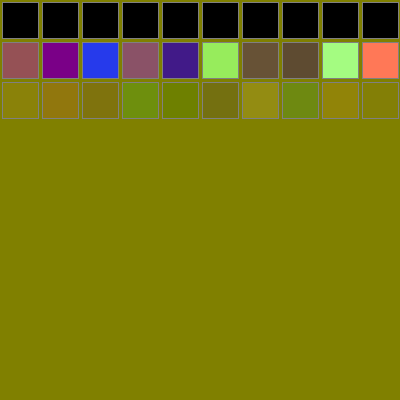

In [4]:
# Exemplo de Má População: Todas as mariposas com cores distantes do ambiente (verde-oliva)
bad_population = [[(0, 0, 0) for _ in range(10)] for _ in range(10)]  # Todas em preto

# Exemplo de População Mediana: Mariposas com cores mistas
median_population = [[(random.randint(0, 255), random.randint(0, 255), random.randint(0, 255)) for _ in range(10)] for _ in range(10)]
median_population = [
    [tuple(min(max(c + random.randint(-50, 50), 0), 255) for c in gene) for gene in row]
    for row in median_population
]

# Exemplo de Boa População: Mariposas com cores próximas ao ambiente (verde-oliva)
good_population = [[(random.randint(110, 150), random.randint(110, 150), random.randint(0, 20)) for _ in range(10)] for _ in range(10)]

sample = [bad_population[0], median_population[0], good_population[0]]

draw_population(sample, bg_color=(128, 128, 0), grid_size_x=10, grid_size_y=3)


In [12]:
print("[first] Final Result:")

draw_population( _history[0] , tile_size=40, bg_color=environment, grid_size_x=POPULATION_SIZE, grid_size_y=GENE_LENGTH)


[first] Final Result:


In [ ]:
print("[last] Final Result:")

last_pos = len(_history)-1

_history[last_pos]

draw_population( _history[last_pos] , tile_size=40, bg_color=environment, grid_size_x=POPULATION_SIZE, grid_size_y=GENE_LENGTH)


In [ ]:
# print("Resultado final:")

# for idx, i in enumerate(_history):
#     print('idx:', idx+1)
#     draw_population(i, tile_size=40, bg_color=environment, grid_size_x=POPULATION_SIZE, grid_size_y=GENE_LENGTH)
#     time.sleep(5)
